<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"></ul></div>

**CONTESTO:**
Si prevede che la nostra popolazione mondiale crescerà dai 7,3 miliardi di oggi a 9,7 miliardi nell'anno 2050. Trovare soluzioni per nutrire la popolazione mondiale in crescita è diventato un tema scottante per le organizzazioni, gli imprenditori e i filantropi dell'agricoltura e dell'alimentazione.

Queste soluzioni vanno dal cambiamento del modo in cui coltiviamo e alleviamo il nostro cibo al cambiamento del modo in cui mangiamo. 
Per rendere le cose più difficili, il clima della Terra sta cambiando ed è influenzato dall'agricoltura. Poiché la popolazione mondiale si è espansa e si è arricchita, la domanda di cibo, energia e acqua ha visto un rapido aumento.
Non solo è aumentata la domanda per tutti e tre, ma sono anche fortemente interconnessi: la produzione alimentare richiede acqua ed energia; la produzione energetica tradizionale richiede risorse idriche; l'agricoltura fornisce una potenziale fonte di energia e tanta acqua. 
 
 
**OBIETTIVO:** 
A partire dai dati inerenti alla produzione e distribuzione mondiale di alimenti e mangimi si analizzi l'impatto negativo che questi hanno sull'ambiente. Una volta terminata l'EDA, utilizza i metodi di scaling ed encoding visti a lezione per preparare al meglio il dataset per un ipotetico modello predittivo ( vedi data preprocessing ) :

qui di seguito alcune domande per ispirarti

- quali sono i 5 alimenti e mangimi che hanno l'impatto peggiore sull'ambiente ?
- qual è il paese che nel tempo è più riuscito a diminuire l'impatto negativo della propria produzione e distribuzione di alimenti e mangimi?


**Dati a disposizione:**

- A questo link (https://www.kaggle.com/datasets/dorbicycle/world-foodfeed-production), sul sito di Kaggle, trovi il primo dataset utile che fornisce una panoramica della nostra produzione alimentare mondiale, concentrandosi su un confronto tra alimenti prodotti per il consumo umano e mangimi prodotti per animali.

- Questo dataset è messo a disposizione dall’Organizzazione delle Nazioni Unite, che per l'alimentazione e l'agricoltura fornisce libero accesso ai dati su cibo e agricoltura per oltre 245 paesi e territori (il csv nominato 'FAOSTAT_data_3-24-2022' in allegato alla traccia), dall'anno 1961 all'aggiornamento più recente.

- Mentre il secondo dataset utile presente a questo link (https://www.kaggle.com/selfvivek/environment-impact-of-food-production) contiene i 43 alimenti più comuni coltivati ​​in tutto il mondo e 23 colonne che descrivono valori come l’utilizzo dell'acqua ed emissioni di gas serra.

In [1]:
#Import libraries

import numpy as np
import pandas as pd
import matplotlib as mpl
from matplotlib import pyplot as plt
from mpl_toolkits.basemap import Basemap
import seaborn as sns
import plotly.express as px
import warnings

warnings.filterwarnings('ignore')

#from sklearn.preprocessing import MinMaxScaler
#from sklearn.preprocessing import MaxAbsScaler
#from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import OneHotEncoder

In [2]:
#Import .csv files

fao_raw = pd.read_csv('FAO.csv', encoding='latin1')
faostat_raw = pd.read_csv('FAOSTAT_data_3-24-2022.csv')
fp_raw = pd.read_csv('Food_Production.csv')

In [3]:
fao_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21477 entries, 0 to 21476
Data columns (total 63 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Area Abbreviation  21477 non-null  object 
 1   Area Code          21477 non-null  int64  
 2   Area               21477 non-null  object 
 3   Item Code          21477 non-null  int64  
 4   Item               21477 non-null  object 
 5   Element Code       21477 non-null  int64  
 6   Element            21477 non-null  object 
 7   Unit               21477 non-null  object 
 8   latitude           21477 non-null  float64
 9   longitude          21477 non-null  float64
 10  Y1961              17938 non-null  float64
 11  Y1962              17938 non-null  float64
 12  Y1963              17938 non-null  float64
 13  Y1964              17938 non-null  float64
 14  Y1965              17938 non-null  float64
 15  Y1966              17938 non-null  float64
 16  Y1967              179

In [4]:
faostat_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 267665 entries, 0 to 267664
Data columns (total 14 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Domain Code       267665 non-null  object 
 1   Domain            267665 non-null  object 
 2   Area Code         267665 non-null  int64  
 3   Area              267665 non-null  object 
 4   Element Code      267665 non-null  int64  
 5   Element           267665 non-null  object 
 6   Months Code       267665 non-null  int64  
 7   Months            267665 non-null  object 
 8   Year Code         267665 non-null  int64  
 9   Year              267665 non-null  int64  
 10  Unit              267665 non-null  object 
 11  Value             259225 non-null  float64
 12  Flag              267665 non-null  object 
 13  Flag Description  267665 non-null  object 
dtypes: float64(1), int64(5), object(8)
memory usage: 28.6+ MB


In [5]:
fp_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43 entries, 0 to 42
Data columns (total 23 columns):
 #   Column                                                                   Non-Null Count  Dtype  
---  ------                                                                   --------------  -----  
 0   Food product                                                             43 non-null     object 
 1   Land use change                                                          43 non-null     float64
 2   Animal Feed                                                              43 non-null     float64
 3   Farm                                                                     43 non-null     float64
 4   Processing                                                               43 non-null     float64
 5   Transport                                                                43 non-null     float64
 6   Packging                                                                 43 

In [6]:
fao_raw.head()

,Area Abbreviation,Area Code,Area,Item Code,Item,Element Code,Element,Unit,latitude,longitude,...,Y2004,Y2005,Y2006,Y2007,Y2008,Y2009,Y2010,Y2011,Y2012,Y2013
0,AFG,2,Afghanistan,2511,Wheat and products,5142,Food,1000 tonnes,33.94,67.71,...,3249.0,3486.0,3704.0,4164.0,4252.0,4538.0,4605.0,4711.0,4810,4895
1,AFG,2,Afghanistan,2805,Rice (Milled Equivalent),5142,Food,1000 tonnes,33.94,67.71,...,419.0,445.0,546.0,455.0,490.0,415.0,442.0,476.0,425,422
2,AFG,2,Afghanistan,2513,Barley and products,5521,Feed,1000 tonnes,33.94,67.71,...,58.0,236.0,262.0,263.0,230.0,379.0,315.0,203.0,367,360
3,AFG,2,Afghanistan,2513,Barley and products,5142,Food,1000 tonnes,33.94,67.71,...,185.0,43.0,44.0,48.0,62.0,55.0,60.0,72.0,78,89
4,AFG,2,Afghanistan,2514,Maize and products,5521,Feed,1000 tonnes,33.94,67.71,...,120.0,208.0,233.0,249.0,247.0,195.0,178.0,191.0,200,200


In [7]:
faostat_raw.head()

,Domain Code,Domain,Area Code,Area,Element Code,Element,Months Code,Months,Year Code,Year,Unit,Value,Flag,Flag Description
0,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1961,1961,?C,0.746,Fc,Calculated data
1,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1962,1962,?C,0.009,Fc,Calculated data
2,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1963,1963,?C,2.695,Fc,Calculated data
3,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1964,1964,?C,-5.277,Fc,Calculated data
4,ET,Temperature change,2,Afghanistan,7271,Temperature change,7001,January,1965,1965,?C,1.827,Fc,Calculated data


In [8]:
fp_raw.head()

,Food product,Land use change,Animal Feed,Farm,Processing,Transport,Packging,Retail,Total_emissions,Eutrophying emissions per 1000kcal (gPO₄eq per 1000kcal),...,Freshwater withdrawals per 100g protein (liters per 100g protein),Freshwater withdrawals per kilogram (liters per kilogram),Greenhouse gas emissions per 1000kcal (kgCO₂eq per 1000kcal),Greenhouse gas emissions per 100g protein (kgCO₂eq per 100g protein),Land use per 1000kcal (m² per 1000kcal),Land use per kilogram (m² per kilogram),Land use per 100g protein (m² per 100g protein),Scarcity-weighted water use per kilogram (liters per kilogram),Scarcity-weighted water use per 100g protein (liters per 100g protein),Scarcity-weighted water use per 1000kcal (liters per 1000 kilocalories)
0,Wheat & Rye (Bread),0.1,0.0,0.8,0.2,0.1,0.1,0.1,1.4,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Maize (Meal),0.3,0.0,0.5,0.1,0.1,0.1,0.0,1.1,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Barley (Beer),0.0,0.0,0.2,0.1,0.0,0.5,0.3,1.1,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Oatmeal,0.0,0.0,1.4,0.0,0.1,0.1,0.0,1.6,4.281357,...,371.076923,482.4,0.945482,1.907692,2.897446,7.6,5.846154,18786.2,14450.92308,7162.104461
4,Rice,0.0,0.0,3.6,0.1,0.1,0.1,0.1,4.0,9.514379,...,3166.760563,2248.4,1.207271,6.267606,0.759631,2.8,3.943662,49576.3,69825.77465,13449.891480


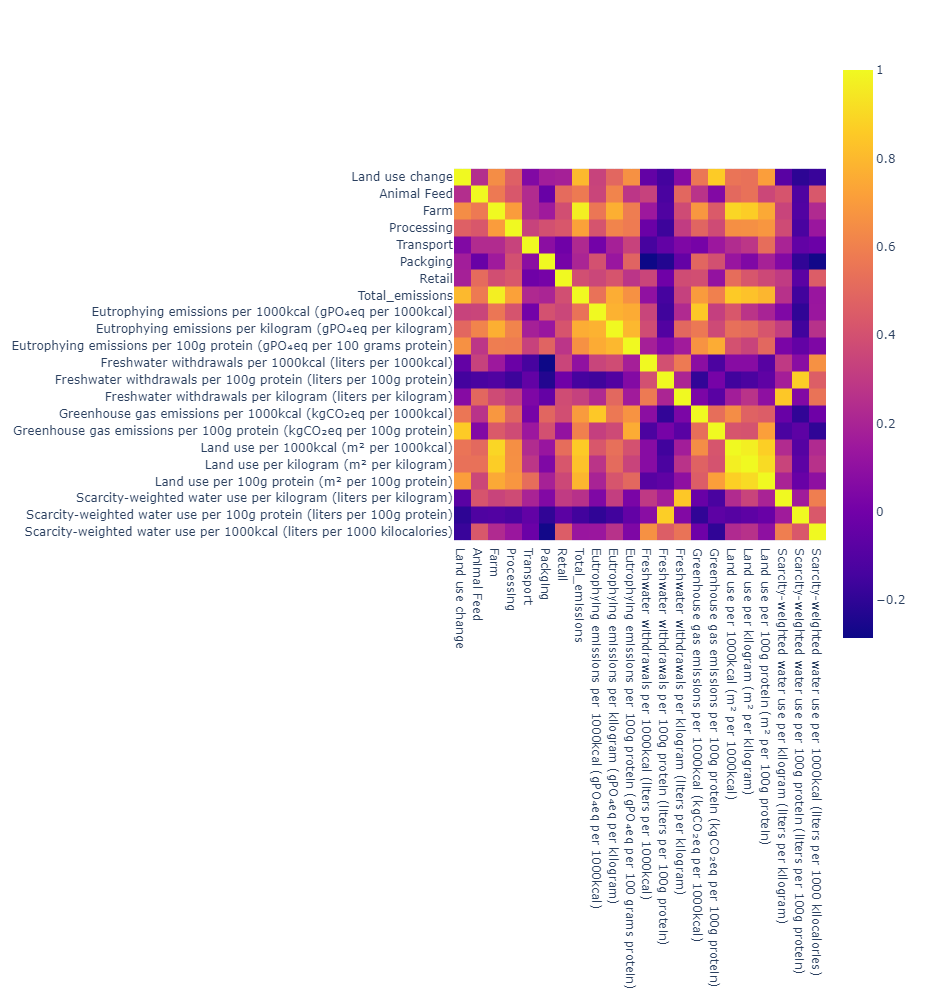

In [50]:
#Heat map Correlation matrix

fig = px.imshow(fp_raw.corr(),x=list(fp_raw.corr().columns),y=list(fp_raw.corr().columns),width=1000, height=1000)
fig.show()

### Data Cleaning

In [9]:
#fao_raw data cleaning

fao_raw = fao_raw.drop(['Area Abbreviation','Area Code','Item Code','Element Code','Unit'], axis=1) #remove unused columns

In [10]:
fao_raw = fao_raw.drop_duplicates(subset=['Area','Item','Element','Y2013'], keep='first') #drop duplicate rows

In [11]:
fao = fao_raw.fillna(0) #replace NA with 0

In [12]:
fao.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21018 entries, 0 to 21476
Data columns (total 58 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Area       21018 non-null  object 
 1   Item       21018 non-null  object 
 2   Element    21018 non-null  object 
 3   latitude   21018 non-null  float64
 4   longitude  21018 non-null  float64
 5   Y1961      21018 non-null  float64
 6   Y1962      21018 non-null  float64
 7   Y1963      21018 non-null  float64
 8   Y1964      21018 non-null  float64
 9   Y1965      21018 non-null  float64
 10  Y1966      21018 non-null  float64
 11  Y1967      21018 non-null  float64
 12  Y1968      21018 non-null  float64
 13  Y1969      21018 non-null  float64
 14  Y1970      21018 non-null  float64
 15  Y1971      21018 non-null  float64
 16  Y1972      21018 non-null  float64
 17  Y1973      21018 non-null  float64
 18  Y1974      21018 non-null  float64
 19  Y1975      21018 non-null  float64
 20  Y1976 

### Data Visualisation

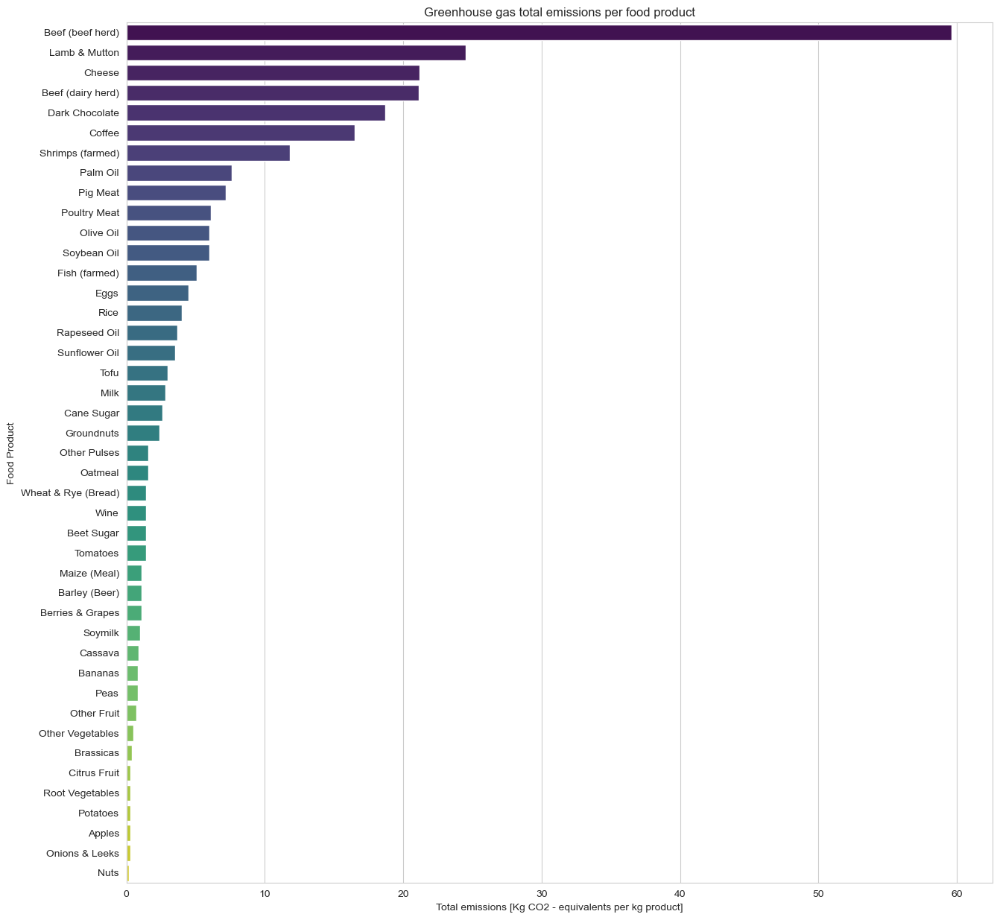

In [13]:
#Greenhouse gas total emissions per food product barplot

sns.set_style('whitegrid')
plt.figure(figsize = (15,15))

# Sort the table
data1 = fp_raw.sort_values(by=['Total_emissions'], ascending=False)

#Barplot
sns.barplot(x='Total_emissions', y='Food product', data=data1, orient='h', palette='viridis')
plt.xlabel('Total emissions [Kg CO2 - equivalents per kg product]');
plt.ylabel('Food Product');
plt.title('Greenhouse gas total emissions per food product');

# show the plot
plt.show()

I 10 cibi a maggiore impatto ambientale in termini di emissioni totali di Co2 equivalente sono in ordine decrescente la carne di manzo, l'agnello e il montone, il formaggio, i prodotti caseari di latte vaccino, cioccolato nero, caffè, gamberetti allevati, olio di palma, carne di maiale e carne di pollo. Considerando tutto il ciclo di vita del prodotto, la carne di manzo comporta emissioni equivalenti di CO2 pari a +143% rispetto alla carne di agnello o montone e a +727% rispetto alla carne di maiale e +877% rispetto alla carne di pollo.

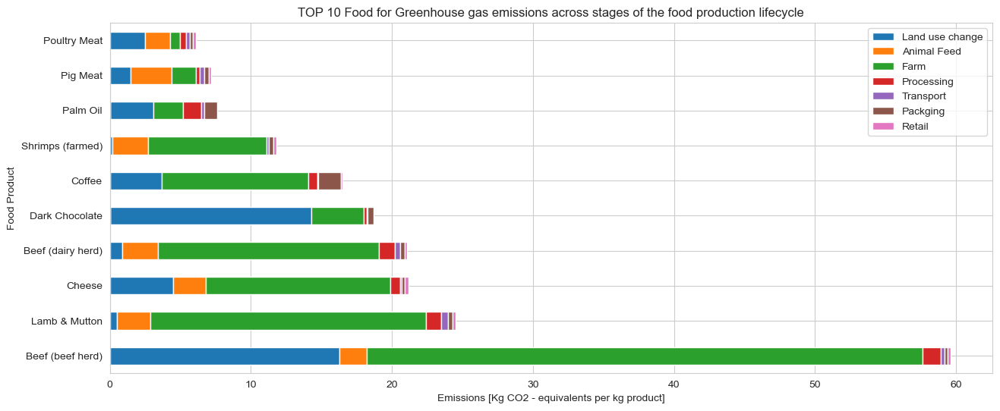

In [14]:
#TOP10 Food for greenhouse gas emissions across stages of food production lifecyle barplot

# Sort the table
data2 = fp_raw.sort_values(by=['Total_emissions'], ascending=False)
data2 = data2.iloc[0:10, 0:8]
data2.plot.barh(figsize=(15,6),stacked=True)

# set the y-axis tick labels
plt.yticks(range(10), data2['Food product'][0:10])

# set the title and labels for the plot
plt.xlabel('Emissions [Kg CO2 - equivalents per kg product]')
plt.ylabel('Food Product')
plt.title('TOP 10 Food for Greenhouse gas emissions across stages of the food production lifecycle')

# turn on the grid lines
plt.grid(True)

# show the plot
plt.show()

L'impatto ambientale in termini di CO2 equivalente più significativo nel ciclo di vita della carne bovina è dovuto alle emissioni di metano delle mucche, metano dal riso, emissioni dei fertilizzanti, letame e macchinari. E' interessante notare che non per tutti i cibi il contributo legato all'azienda agricola è così significativo. Ad esempio nel caso della produzione di cioccolato è più impattante il consumo di terra in termini di deforestazione e variazioni del livello di carbonio nel suolo.

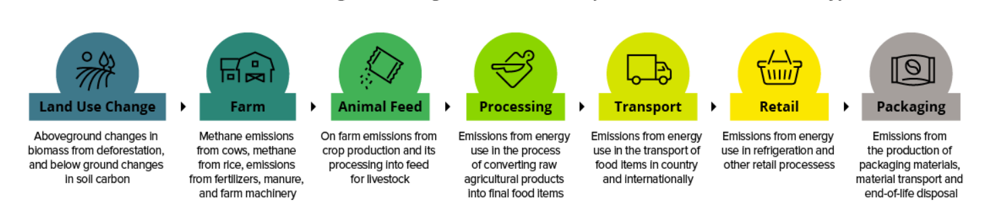

**Source:** https://www.visualcapitalist.com/visualising-the-greenhouse-gas-impact-of-each-food/

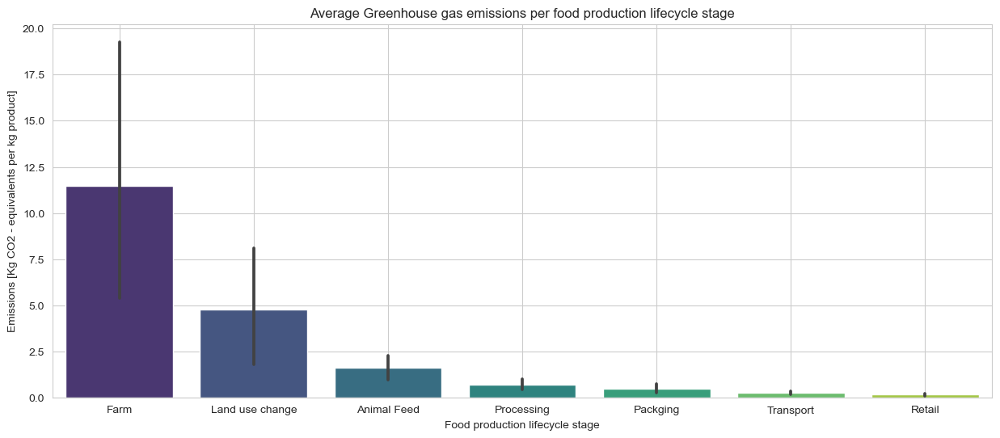

In [15]:
#Average Greenhouse gas emissions per food prodcution lifecycle stage

sns.set_style('whitegrid')
plt.figure(figsize = (15,6))

data3 = data2.reindex(data2.mean().sort_values(ascending=False).index, axis=1)

#barplot
sns.barplot(data=data3, palette='viridis')

plt.xlabel('Food production lifecycle stage')
plt.ylabel('Emissions [Kg CO2 - equivalents per kg product]')
plt.title('Average Greenhouse gas emissions per food production lifecycle stage')
plt.grid(True)

plt.show()

Come già visto nel grafico precedente, il contributo prevalente nel ciclo di vita dei prodotti alimentari è dovuto all'impatto dell'azienda agricola. Questo è generalmente più evidente nel caso in cui il prodotto alimentare sia di origine animale (carni, prodotti caseari di origine animale)

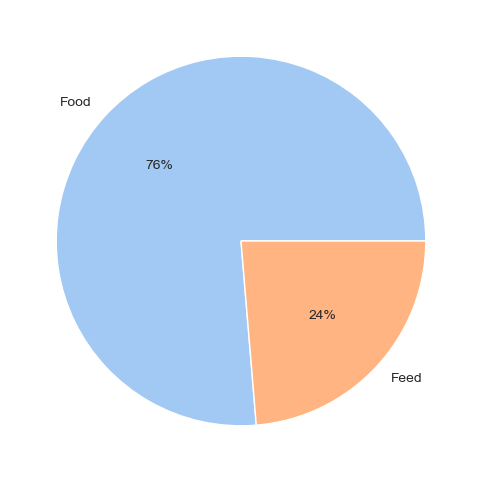

In [16]:
#Food or Feed?

data4 = fao.groupby('Element').sum()
data4 = data4.iloc[:,2:58].sort_values(by=['Y2013'], ascending=False).T.sum()

plt.figure(figsize = (15,6))

#define Seaborn color palette to use
colors = sns.color_palette('pastel')[0:5]

#define labels
labels = ['Food','Feed']

#create pie chart
plt.pie(data4, labels=labels, colors = colors, autopct='%.0f%%')
plt.show()

Il 76% della produzione di cibo mondiale dal 1961 al 2013 è stata destitata ad umano, mentre il 24% restante è stata destinata ad uso animale.

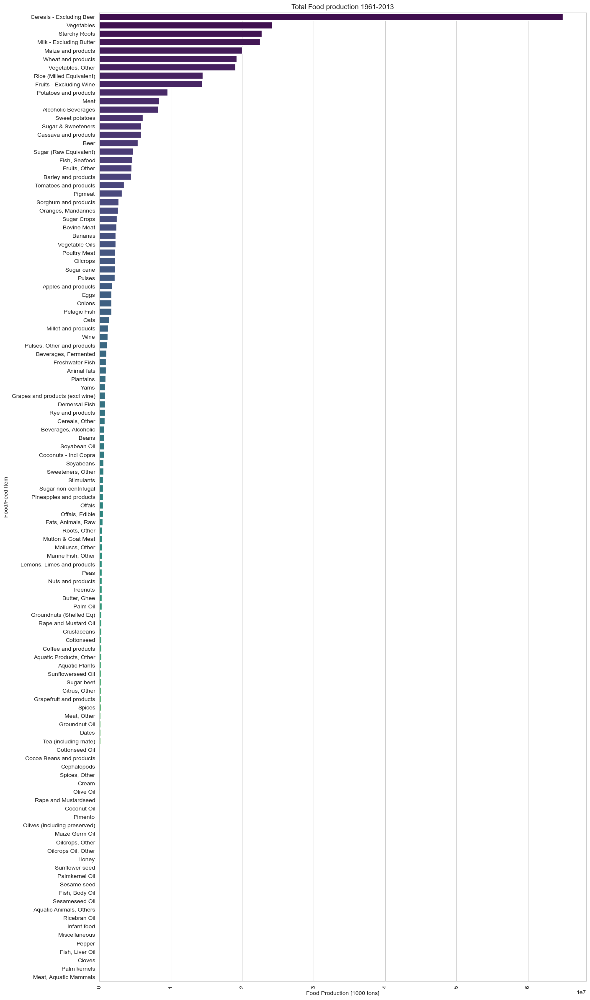

In [17]:
#Total food production 1961-2013 barplot

data5 = fao.groupby('Item').sum().T
data5 = data5.drop(['latitude', 'longitude'],axis = 0)
data5 = data5.sum().sort_values(ascending=False)

df = pd.DataFrame(data5, columns=['total'])
df.reset_index(inplace=True)
plt.figure(figsize = (15,30))

#barplot
sns.set_style('whitegrid')
sns.barplot(x='total', y='Item', data=df, palette='viridis')
plt.xticks(rotation=90)
plt.xlabel('Food Production [1000 tons]')
plt.ylabel('Food/Feed Item')
plt.title('Total Food production 1961-2013')

plt.show()

I cibi prodotti a livello mondiale in maggiore quantità, dal 1961 al 2013 sono di origine vegetale (Cereali, vegetali, tuberi, latte, mais, grano, riso, frutta, patate) eccetto per il latte che è di origine animale.

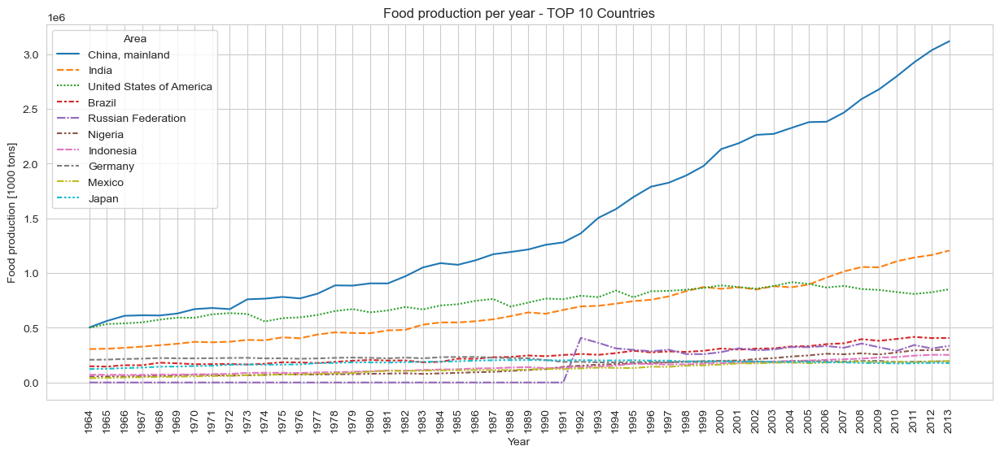

In [18]:
# Food production per year - TOP 10 Countries plot

data6 = fao.groupby('Area').sum()
data6 = data6.iloc[:,5:58].sort_values(by=['Y2013'], ascending=False).T
data6.index = data6.index.str.slice(1)

sns.set_style('whitegrid')
plt.figure(figsize = (15,6))

#lineplot
sns.lineplot(data=data6.iloc[:,0:10])

# set x-axis label rotation
plt.xticks(rotation=90)

plt.xlabel('Year')
plt.ylabel('Food production [1000 tons]')
plt.title('Food production per year - TOP 10 Countries')
plt.grid(True)

plt.show()

Nel grafico viene visualizzata la produzione di cibo dal 1961 al 2013 per i 10 maggiori paesi produttori. La Cina domina la produzione con più di 3 miliardi di tonnellate nel 2013, l'India è al secondo posto con più di 1 miliardo di tonnellate e gli Stati Uniti d'America sono al terzo posto con meno di un miliardo di tonnellate di cibo prodotto.

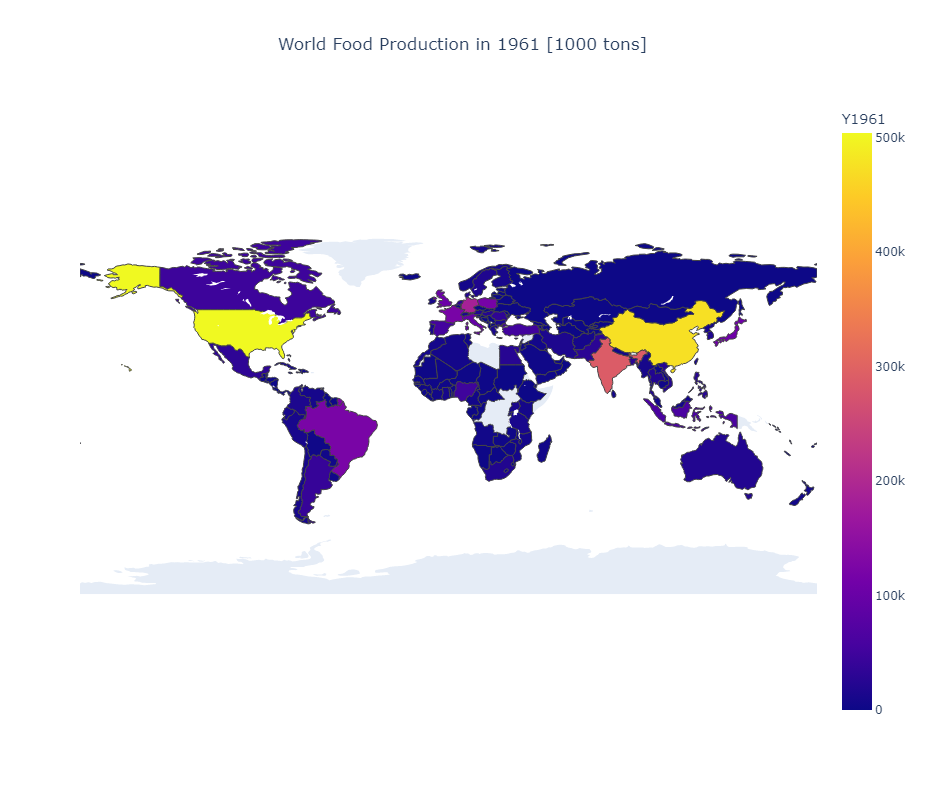

In [46]:
#Food production world map in 1961

food_prod = fao.groupby('Area').sum()

# Create the choropleth map
fig = px.choropleth(food_prod, 
                    locations=food_prod.index, 
                    locationmode='country names',
                    color='Y1961', 
                    range_color=[food_prod['Y1961'].min(), food_prod['Y1961'].max()], 
                    color_continuous_scale=px.colors.sequential.Plasma, 
                    title='World Food Production in 1961 [1000 tons]')

# Update the layout and configuration
fig.update_layout(
    height=800,
    width=900,
    title_x=0.5,
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'),)

# Show the figure
fig.show()

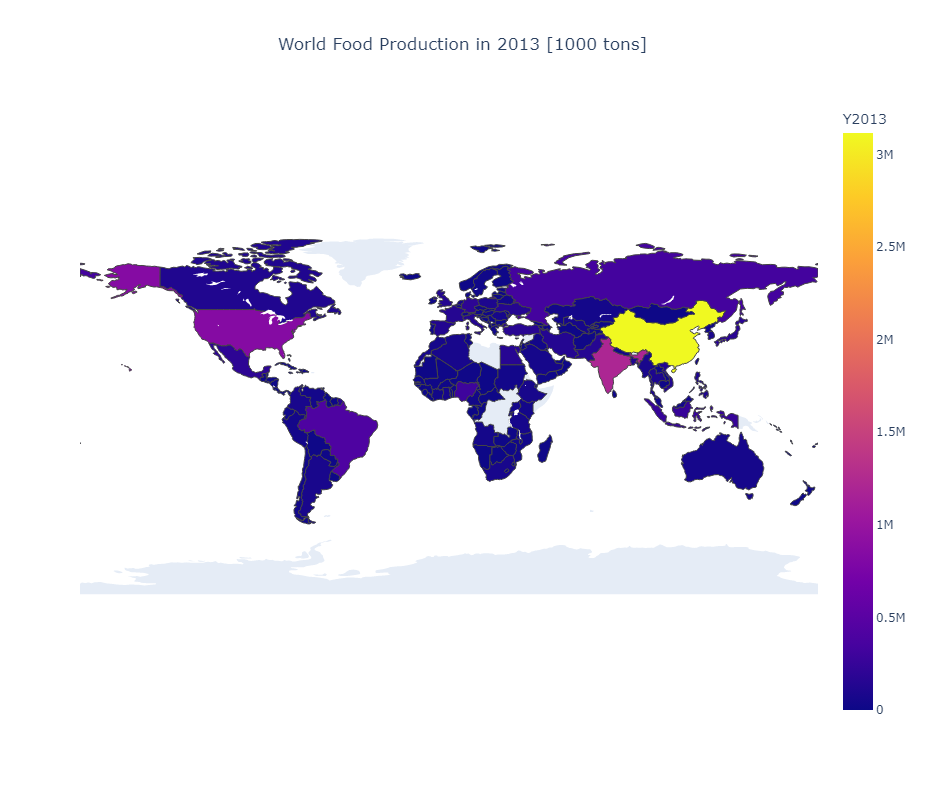

In [45]:
#Food production world map in 2013

food_prod = fao.groupby('Area').sum()

# Create the choropleth map
fig = px.choropleth(food_prod, 
                    locations=food_prod.index, 
                    locationmode='country names',
                    color='Y2013', 
                    range_color=[food_prod['Y2013'].min(), food_prod['Y2013'].max()], 
                    color_continuous_scale=px.colors.sequential.Plasma, 
                    title='World Food Production in 2013 [1000 tons]')

# Update the layout and configuration
fig.update_layout(
    height=800,
    width=900,
    title_x=0.5,
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'),)

# Show the figure
fig.show()

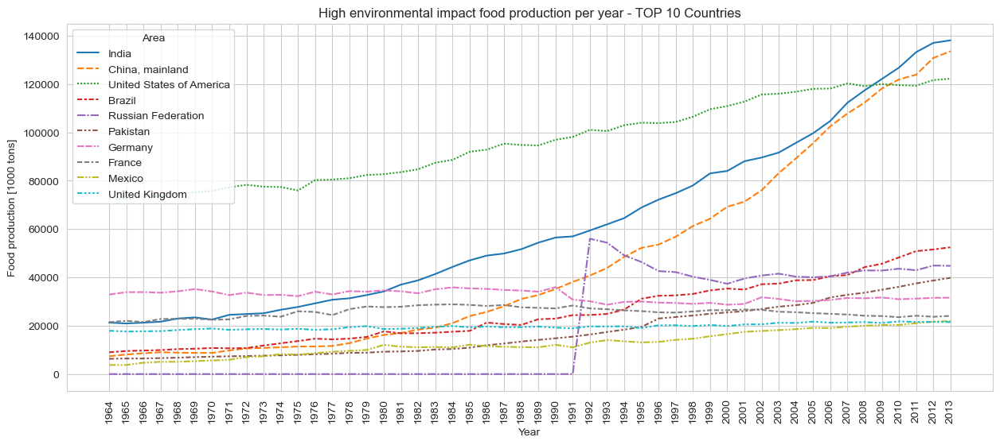

In [20]:
#High environmental impact food production per year - TOP 10 countries plot

data7 = fao[(fao['Item'] == 'Palm Oil') | 
        (fao['Item'] == 'Coffee and products') | (fao['Item'] == 'Cocoa beans and products')
       | (fao['Item'] == 'Bovine Meat') | (fao['Item'] == 'Mutton and Goat Meat')
       | (fao['Item'] == 'Poultry Meat') | (fao['Item'] == 'Pigmeat')
       | (fao['Item'] == 'Milk - Excluding Butter') | (fao['Item'] == 'Crustaceans')
       | (fao['Item'] == 'Butter, Ghee')].groupby('Area').sum()

data7 = data7.iloc[:,5:58].sort_values(by=['Y2013'], ascending=False).T
data7.index = data7.index.str.slice(1)

sns.set_style('whitegrid')
plt.figure(figsize = (15,6))

#lineplot
sns.lineplot(data=data7.iloc[:,0:10])

# set x-axis label rotation
plt.xticks(rotation=90)

plt.xlabel('Year')
plt.ylabel('Food production [1000 tons]')
plt.title('High environmental impact food production per year - TOP 10 Countries')
plt.grid(True)

plt.show()

Nel grafico viene visualizzata la produzione dei 10 cibi più impattanti a livello ambientale in termini di CO2 equivalente per nazione. India, Cina e Stati Uniti d'America risultano sempre i tre maggiori produttori, ma a differenza del grafico precedente (Food Production per Year - TOP 10 countries) si può apprezzare un impatto maggiore di India e Stati Uniti d'America sulla produzione di cibi più dannosi per l'effetto serra.

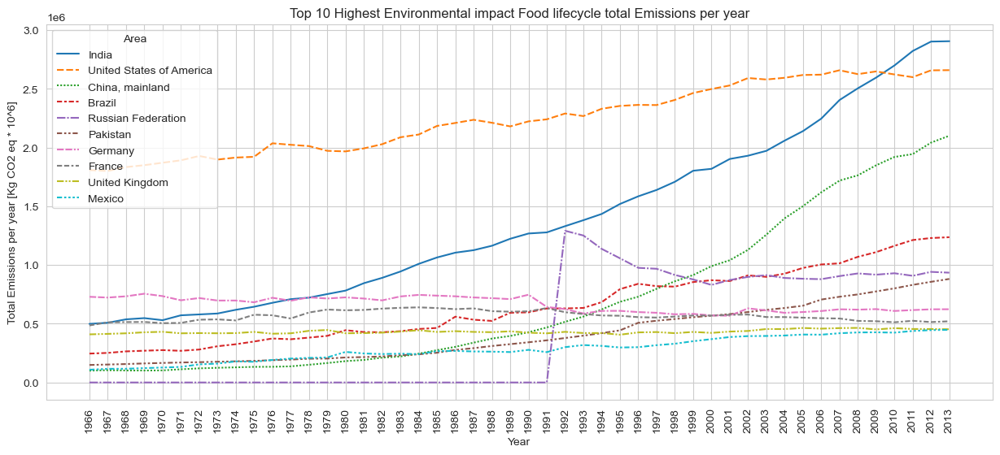

In [21]:
# Top 10 Highest Environmental impact Food lifecycle total Emissions per year plot

# create a list of our conditions
conditions = [(fao['Item'] == 'Bovine Meat'),
                (fao['Item'] == 'Mutton & Goat Meat'),
                (fao['Item'] == 'Butter, Ghee'),
                (fao['Item'] == 'Milk - Excluding Butter'),
                (fao['Item'] == 'Cocoa Beans and products'),
                (fao['Item'] == 'Coffee and products'),
                (fao['Item'] == 'Crustaceans'),
                (fao['Item'] == 'Palm Oil'),
                (fao['Item'] == 'Pigmeat'),
                (fao['Item'] == 'Poultry Meat')]

# create a list of the values we want to assign for each condition
values = [59.6, 24.5, 21.2, 21.1, 18.7, 16.5, 11.8, 7.6, 7.2, 6.1]

# create a new column and use np.select to assign values to it using our lists as arguments
fao['emissions'] = np.select(conditions, values)

data8 = fao.iloc[:,10:-1].T
data8.index = data8.index.str.slice(1)
data8 = data8.T
fao_emissions = data8.multiply(fao['emissions'], axis='index')

fao_emissions.set_index(fao['Area'], inplace=True)
fao_emissions = fao_emissions.groupby('Area').sum()
fao_emissions = fao_emissions.sort_values(by=['2013'], ascending=False).T

sns.set_style('whitegrid')
plt.figure(figsize = (15,6))

sns.lineplot(data=fao_emissions.iloc[:,0:10])

# set x-axis label rotation
plt.xticks(rotation=90)

plt.xlabel('Year')
plt.ylabel('Total Emissions per year [Kg CO2 eq * 10^6]')
plt.title('Top 10 Highest Environmental impact Food lifecycle total Emissions per year')
plt.grid(True)
plt.show()

Nel grafico sopra vengono visualizzate le emissione totali di CO2 equivalente per anno e paese produttore. Come nel grafico precedente (High environmental impact food production per year - TOP 10 Countries) si nota un predominio di India e Stati Uniti ancora più marcato rispetto alla Cina.

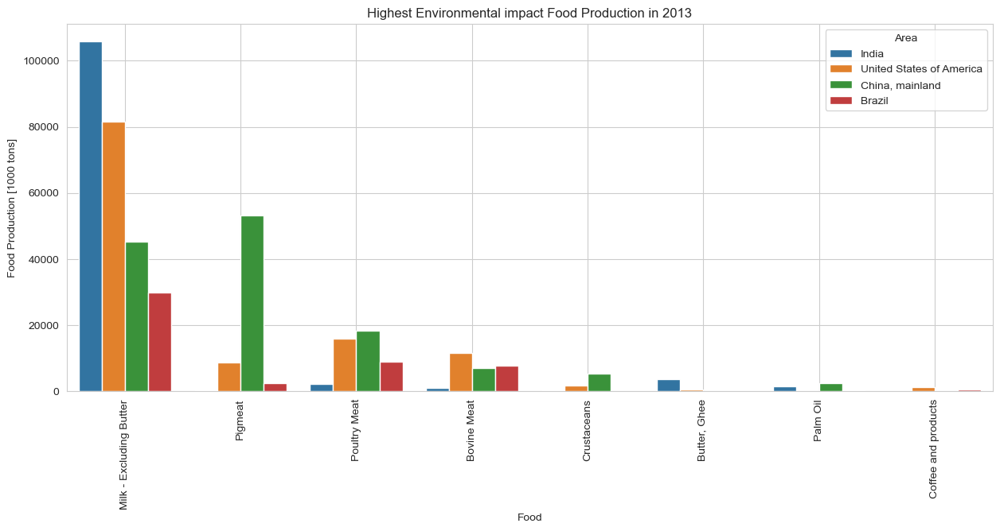

In [22]:
#Highest Environmental Impact Food Production in 2013 barplot

data9 = fao[((fao['Item'] == 'Palm Oil') | (fao['Item'] == 'Coffee and products') 
                 | (fao['Item'] == 'Cocoa beans and products')
                 | (fao['Item'] == 'Bovine Meat') | (fao['Item'] == 'Mutton and Goat Meat')
                 | (fao['Item'] == 'Poultry Meat') | (fao['Item'] == 'Pigmeat')
                 | (fao['Item'] == 'Milk - Excluding Butter') | (fao['Item'] == 'Crustaceans')
                 | (fao['Item'] == 'Butter, Ghee')) & ((fao['Area'] == 'India') | (fao['Area'] == 'China, mainland') 
                 | (fao['Area'] == 'United States of America') | (fao['Area'] == 'Brazil')) & (fao['Element'] == 'Food')].sort_values(by=['Y2013'], ascending=False)

data9 = data9.drop_duplicates(subset=['Item','Element','Y2013'], keep='first')

sns.set_style('whitegrid')
plt.figure(figsize = (15,6))

sns.barplot(data=data9, x='Item', y='Y2013', hue='Area')

# set x-axis label rotation
plt.xticks(rotation=90)

plt.xlabel('Food')
plt.ylabel('Food Production [1000 tons]')
plt.title('Highest Environmental impact Food Production in 2013')
plt.grid(True)
plt.show()

Nel grafico a barre sopra vengono visualizzate le produzioni di cibo più impattanti in termini di CO2 equivalente per le quattro maggiori nazioni produttrici al mondo. E' interessante notare come l'India sia il maggiore produttore di latte vaccino ma la produzione di carne sia molto bassa rispetto agli Stati Uniti d'America che primeggiano nella produzione di carne bovina. La Cina primeggia invece nella produzione di carne di maiale, come abbiamo già visto molto meno impattante per l'ambiente rispetto alla carne di manzo.

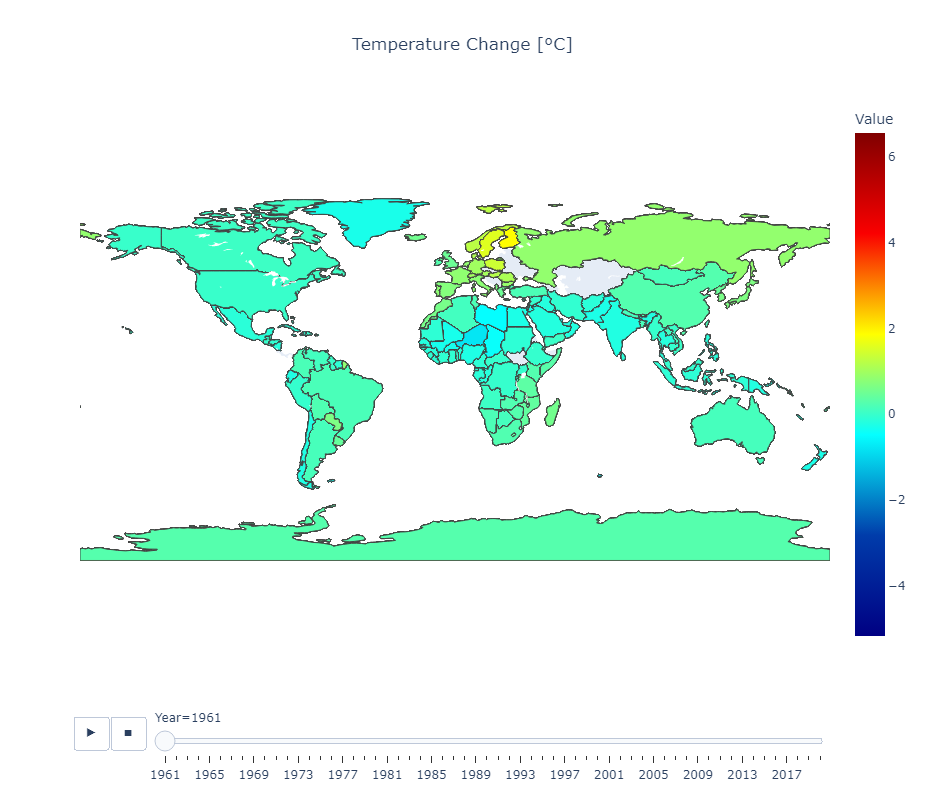

In [61]:
#Cloropleth timeframe animation of world temperature change with respect to baseline

# Create the choropleth map with animation
fig = px.choropleth(faostat_raw, 
                    locations='Area', 
                    locationmode='country names',
                    color='Value', 
                    range_color=[faostat_raw['Value'].quantile(q=0.0005), faostat_raw['Value'].quantile(q=0.9995)], 
                    animation_frame='Year',
                    color_continuous_scale=px.colors.sequential.Jet, 
                    title='Temperature Change [°C]')

# Update the layout and configuration
fig.update_layout(
    height=800,
    width=900,
    title_x=0.5,
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'),)

# Show the figure
fig.show()


### Scaling e Enconding

In [23]:
fao_toscale= fao.drop(fao_raw.columns[0:5], axis=1)
scaler = RobustScaler()
fao_scaled = scaler.fit_transform(fao_toscale)
fao_scaled = pd.DataFrame(fao_scaled)
fao_scaled

,0,1,2,3,4,5,6,7,8,9,...,44,45,46,47,48,49,50,51,52,53
0,175.272727,173.090909,138.833333,150.000000,153.923077,129.142857,146.642857,136.333333,143.600000,121.266667,...,51.191176,52.084507,56.958904,56.039604,60.413333,59.714286,58.8000,58.573171,57.494118,0.0
1,16.636364,16.636364,15.166667,16.923077,16.923077,13.928571,16.500000,15.666667,15.866667,14.200000,...,6.470588,7.605634,6.150685,6.376238,5.440000,5.649351,5.8625,5.097561,4.870588,0.0
2,6.909091,6.909091,6.333333,5.846154,5.846154,5.357143,5.071429,4.800000,4.866667,4.933333,...,3.397059,3.605634,3.520548,2.943894,4.960000,4.000000,2.4500,4.390244,4.141176,0.0
3,21.545455,21.545455,19.750000,18.307692,18.307692,16.928571,16.071429,15.133333,15.333333,15.600000,...,0.558824,0.535211,0.575342,0.726073,0.640000,0.688312,0.8125,0.865854,0.952941,0.0
4,19.090909,19.090909,17.833333,16.615385,16.615385,15.428571,16.785714,15.466667,15.733333,13.333333,...,2.985294,3.197183,3.328767,3.168317,2.506667,2.220779,2.3000,2.353659,2.258824,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21013,0.272727,0.272727,0.250000,0.230769,0.230769,0.500000,0.500000,0.533333,0.600000,0.666667,...,0.308824,0.323944,0.315068,0.264026,0.320000,0.298701,0.2250,0.231707,0.141176,0.0
21014,2.454545,2.272727,2.250000,1.769231,2.076923,2.071429,2.000000,1.866667,1.666667,1.666667,...,-0.014706,0.042254,0.000000,0.026403,-0.026667,0.103896,0.1000,0.097561,0.082353,0.0
21015,0.545455,0.545455,0.500000,0.615385,0.692308,0.714286,0.714286,0.666667,0.666667,0.600000,...,0.132353,0.154930,0.109589,0.105611,0.146667,0.285714,0.4125,0.402439,0.376471,0.0
21016,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.073529,-0.084507,-0.082192,-0.092409,-0.093333,-0.090909,-0.0875,-0.085366,-0.094118,0.0


In [24]:
cat_encoder = OneHotEncoder()
fao_area_1hot = cat_encoder.fit_transform(fao[['Area']])
fao_item_1hot = cat_encoder.fit_transform(fao[['Item']])
fao_element_1hot = cat_encoder.fit_transform(fao[['Element']])

In [25]:
fao_area_1hot.toarray().shape

(21018, 174)

In [26]:
fao_item_1hot.toarray().shape

(21018, 115)

In [27]:
fao_element_1hot.toarray().shape

(21018, 2)